# 거울아 거울아, 나는 멍멍이 상이니, 아니면 냥이 상이니? [프로젝트]
### "What flower Are you?


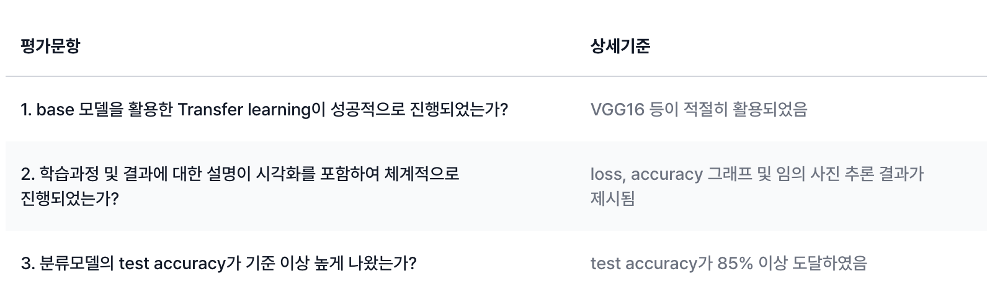

In [57]:
import warnings
warnings.filterwarnings("ignore")

In [58]:
import tensorflow as tf
print(tf.__version__)

2.6.0


In [59]:
import tensorflow_datasets as tfds

tfds.__version__

'4.4.0'

## Step 1. 데이터셋 내려받기
- tfds.load를 활용하여 데이터셋 다운

In [6]:
!mkdir -p ~/aiffel/tf_flowers/flowerImages
!ln -s ~/data/* ~/aiffel/tf_flowers/

In [11]:
(raw_train, raw_validation, raw_test), metadata = tfds.load(
    name='tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    data_dir='~/aiffel/flowers/',
    download=True,
    with_info=True,
    as_supervised=True,
)

In [9]:
print(raw_train)
print(raw_validation)
print(raw_test)

<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>


In [60]:
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

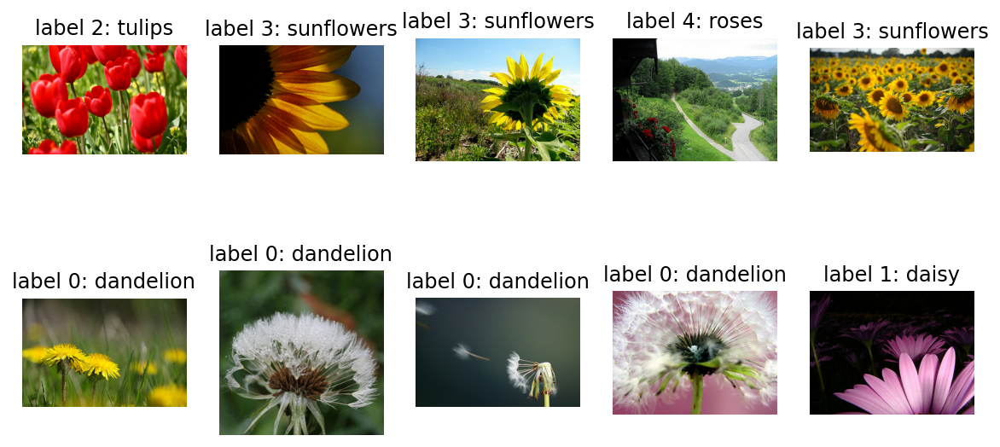

In [11]:
plt.figure(figsize=(10, 5))

get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(raw_train.take(10)):  # 10개의 데이터를 가져 옵니다.
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

## Step 2. 데이터셋을 모델에 넣을 수 있는 형태로 준비하기

In [13]:
IMG_SIZE = 160 # 리사이징할 이미지의 크기

def format_example(image, label):
    image = tf.cast(image, tf.float32)  # image=float(image)같은 타입캐스팅의  텐서플로우 버전입니다.
    image = (image/127.5) - 1 # 픽셀값의 scale 수정
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

In [14]:
train = raw_train.map(format_example)
validation = raw_validation.map(format_example)
test = raw_test.map(format_example)

print(train)
print(validation)
print(test)

<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>


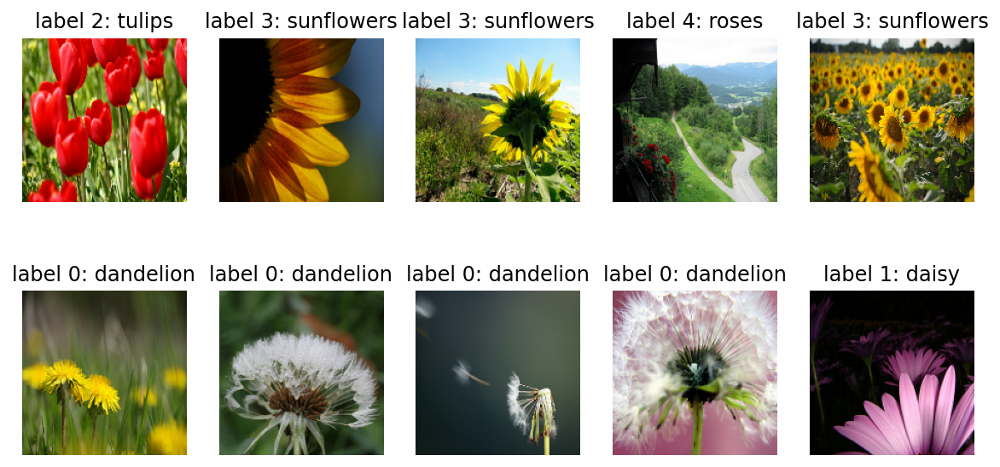

In [15]:
plt.figure(figsize=(10, 5))


get_label_name = metadata.features['label'].int2str

for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

## Step 3. 모델 설계하기

In [16]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D

In [26]:
model = Sequential([
    Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(160, 160, 3)),
    MaxPooling2D(),
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=5, activation='softmax')
])

In [27]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 160, 160, 16)      448       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 80, 80, 16)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 80, 80, 32)        4640      
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 40, 40, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 40, 40, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 25600)            

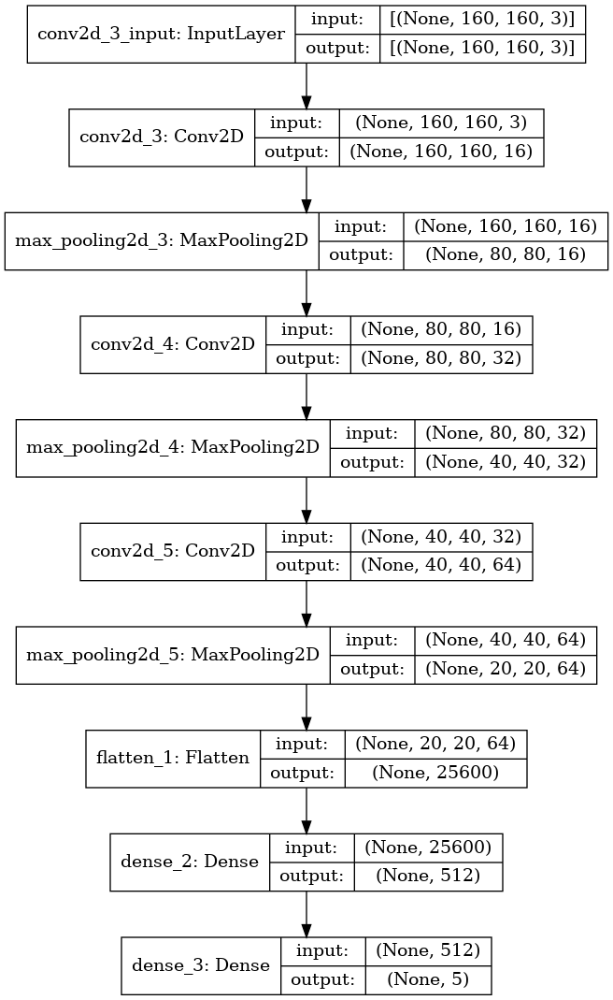

In [28]:
from keras.utils.vis_utils import plot_model
plot_model(model, show_shapes=True)

## Step 4. 모델 학습시키기


In [29]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

In [17]:
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000

In [18]:
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [19]:
for image_batch, label_batch in train_batches.take(1):
    break

image_batch.shape, label_batch.shape

(TensorShape([32, 160, 160, 3]), TensorShape([32]))

In [33]:
# 학습하기 전에
validation_steps = 20
loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

11/20 [===============>..............] - ETA: 0s - loss: 1.6123 - accuracy: 0.2074WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 20 batches). You may need to use the repeat() function when building your dataset.


20/20 [==============================] - 0s 7ms/step - loss: 1.6144 - accuracy: 0.2044
initial loss: 1.61
initial accuracy: 0.20


- 1/5, class 5개이므로 5개중 하나 추측한 확률

In [34]:
# 10번 학습
EPOCHS = 10
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 [==============================] - 4s 30ms/step - loss: 1.4193 - accuracy: 0.4063 - val_loss: 1.1561 - val_accuracy: 0.5504
Epoch 2/10
92/92 [==============================] - 3s 29ms/step - loss: 1.0970 - accuracy: 0.5528 - val_loss: 1.1047 - val_accuracy: 0.5640
Epoch 3/10
92/92 [==============================] - 3s 28ms/step - loss: 0.9557 - accuracy: 0.6366 - val_loss: 1.0078 - val_accuracy: 0.6267
Epoch 4/10
92/92 [==============================] - 3s 28ms/step - loss: 0.8354 - accuracy: 0.6798 - val_loss: 1.0156 - val_accuracy: 0.6104
Epoch 5/10
92/92 [==============================] - 3s 29ms/step - loss: 0.7323 - accuracy: 0.7340 - val_loss: 0.9620 - val_accuracy: 0.6403
Epoch 6/10
92/92 [==============================] - 3s 29ms/step - loss: 0.6575 - accuracy: 0.7629 - val_loss: 0.9562 - val_accuracy: 0.6213
Epoch 7/10
92/92 [==============================] - 3s 29ms/step - loss: 0.5670 - accuracy: 0.7984 - val_loss: 0.9181 - val_accuracy: 0.6567
Epoch 8/10
92

## Step 5. 모델 성능 평가하기


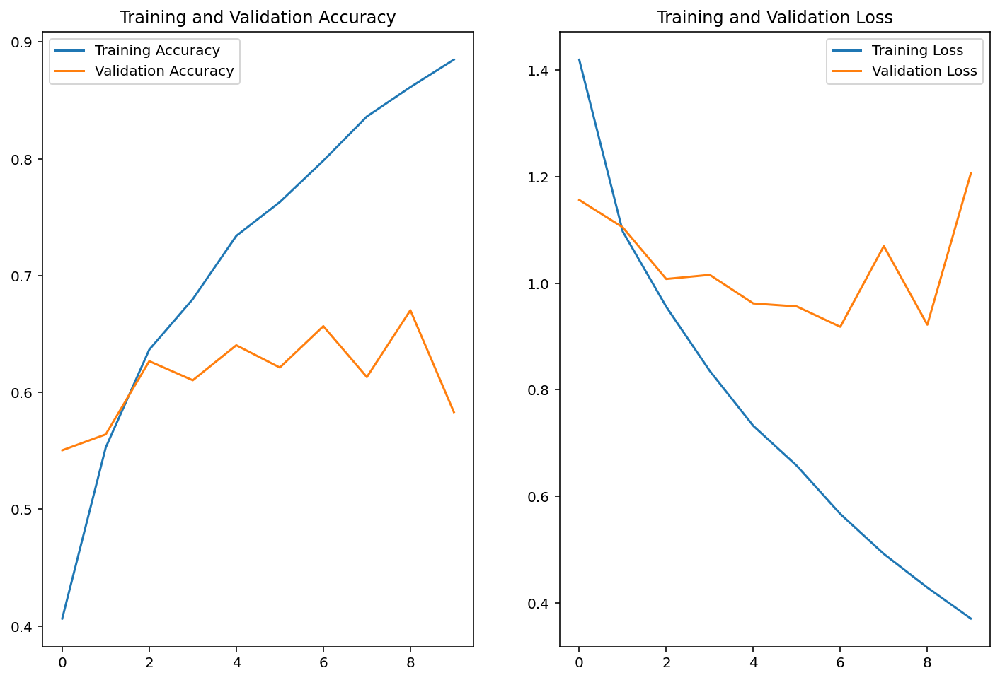

In [35]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [36]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions

array([[3.84290150e-04, 9.72646376e-05, 3.85163799e-02, 7.19643803e-03,
        9.53805625e-01],
       [8.61562610e-01, 1.17015511e-01, 5.12324367e-03, 1.00675774e-04,
        1.61979347e-02],
       [4.24550951e-01, 1.74121689e-02, 1.60312817e-01, 3.94069046e-01,
        3.65499547e-03],
       [1.20520286e-01, 5.13822734e-02, 3.45772892e-01, 2.07195561e-02,
        4.61605042e-01],
       [7.74273634e-01, 2.37116907e-02, 3.75083014e-02, 1.26142306e-02,
        1.51892215e-01],
       [1.12387851e-01, 1.21470634e-02, 4.58301380e-02, 1.00009106e-02,
        8.19634080e-01],
       [2.41490128e-03, 2.27398425e-02, 7.15077102e-01, 5.90519793e-03,
        2.53862917e-01],
       [2.32214890e-02, 1.11534474e-02, 3.94511707e-02, 6.79121586e-03,
        9.19382751e-01],
       [1.13949152e-02, 3.75544587e-05, 1.67578198e-02, 9.71060395e-01,
        7.49271363e-04],
       [9.65654492e-01, 8.87115952e-03, 6.89150998e-04, 6.25493485e-05,
        2.47226637e-02],
       [8.85735333e-01, 1.2156

In [39]:
import numpy as np
predictions = np.argmax(predictions, axis=1)
predictions

array([4, 0, 0, 4, 0, 4, 2, 4, 3, 0, 0, 3, 4, 4, 4, 3, 4, 0, 4, 4, 2, 0,
       1, 0, 4, 0, 4, 4, 4, 3, 0, 0])

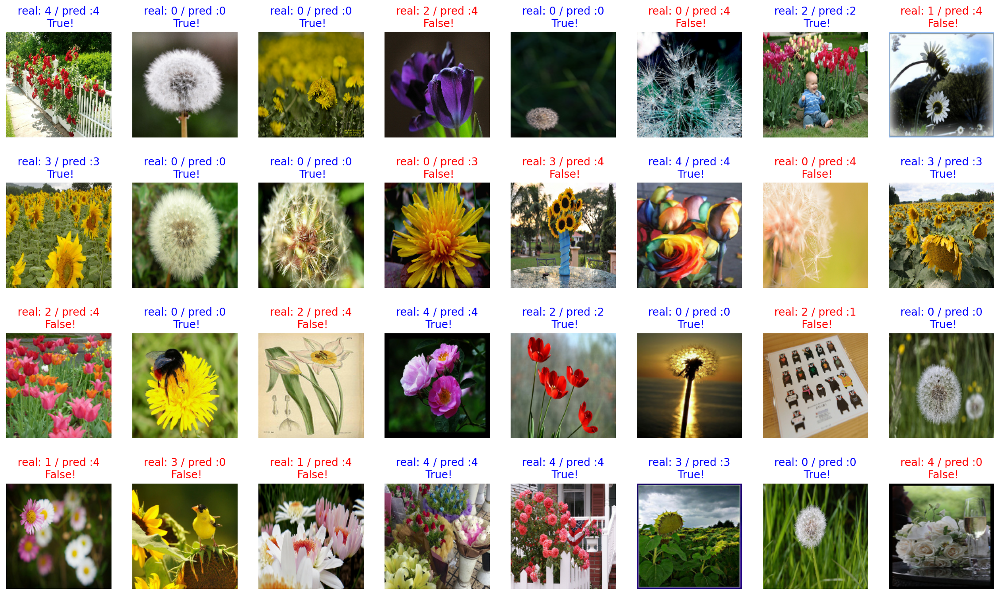

In [40]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [44]:
count = 0   # 정답을 맞춘 개수
for image, label, prediction in zip(images, labels, predictions):
    if label == prediction:
        count += 1

print(count / 32 * 100)

59.375


- 정말 좋지 않다 ~
- test를 할 필요는 없을 것 같다. epoch=2가 되는 시점부터 과적합이 시작된다. 적합한 모델이 아니다.

### 모델 2

In [46]:
from keras.layers import BatchNormalization, Dropout

model = Sequential([
    Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(160, 160, 3)),
    BatchNormalization(),
    MaxPooling2D(),
    Dropout(0.5),
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=5, activation='softmax')
])

In [47]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

In [48]:
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000

In [49]:
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [50]:
for image_batch, label_batch in train_batches.take(1):
    break

image_batch.shape, label_batch.shape

(TensorShape([32, 160, 160, 3]), TensorShape([32]))

In [51]:
# 10번 학습
EPOCHS = 10
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 [==============================] - 4s 34ms/step - loss: 3.2986 - accuracy: 0.3212 - val_loss: 1.4705 - val_accuracy: 0.4823
Epoch 2/10
92/92 [==============================] - 3s 32ms/step - loss: 1.2204 - accuracy: 0.5054 - val_loss: 1.3442 - val_accuracy: 0.4823
Epoch 3/10
92/92 [==============================] - 3s 32ms/step - loss: 1.0285 - accuracy: 0.5882 - val_loss: 1.2049 - val_accuracy: 0.5232
Epoch 4/10
92/92 [==============================] - 3s 32ms/step - loss: 0.8765 - accuracy: 0.6611 - val_loss: 1.0521 - val_accuracy: 0.5804
Epoch 5/10
92/92 [==============================] - 3s 32ms/step - loss: 0.7451 - accuracy: 0.7217 - val_loss: 1.0851 - val_accuracy: 0.5531
Epoch 6/10
92/92 [==============================] - 3s 32ms/step - loss: 0.6671 - accuracy: 0.7548 - val_loss: 0.9224 - val_accuracy: 0.6594
Epoch 7/10
92/92 [==============================] - 3s 32ms/step - loss: 0.5540 - accuracy: 0.7909 - val_loss: 0.8556 - val_accuracy: 0.6866
Epoch 8/10
92

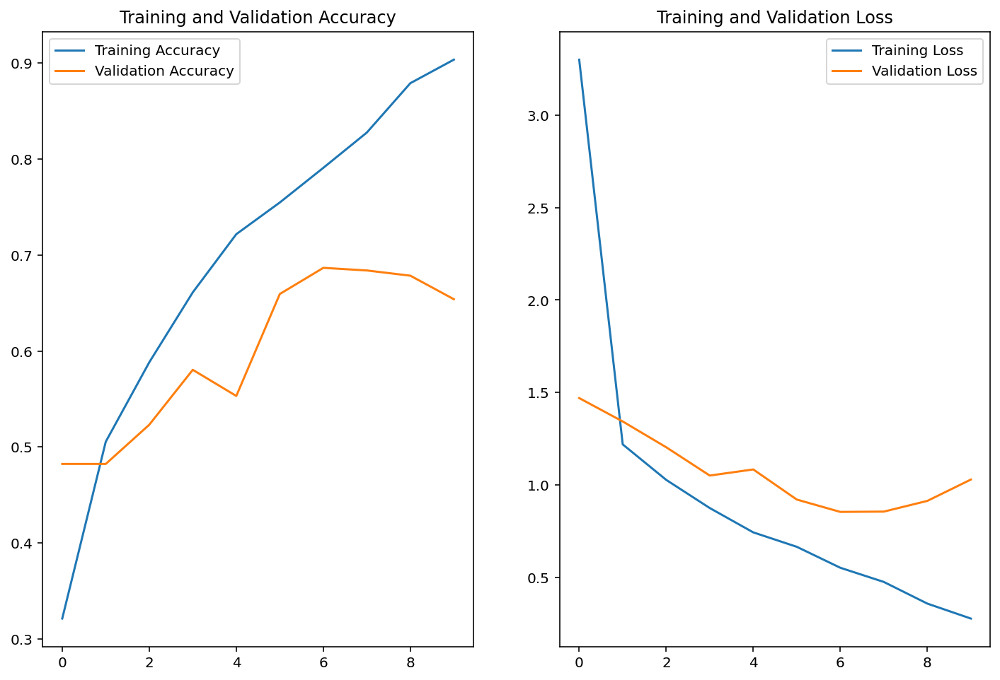

In [52]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

In [53]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break
    
predictions = np.argmax(predictions, axis=1)
predictions

array([3, 0, 0, 2, 0, 3, 2, 4, 3, 0, 0, 3, 3, 2, 0, 3, 4, 0, 0, 4, 2, 0,
       1, 0, 1, 3, 4, 3, 2, 1, 0, 0])

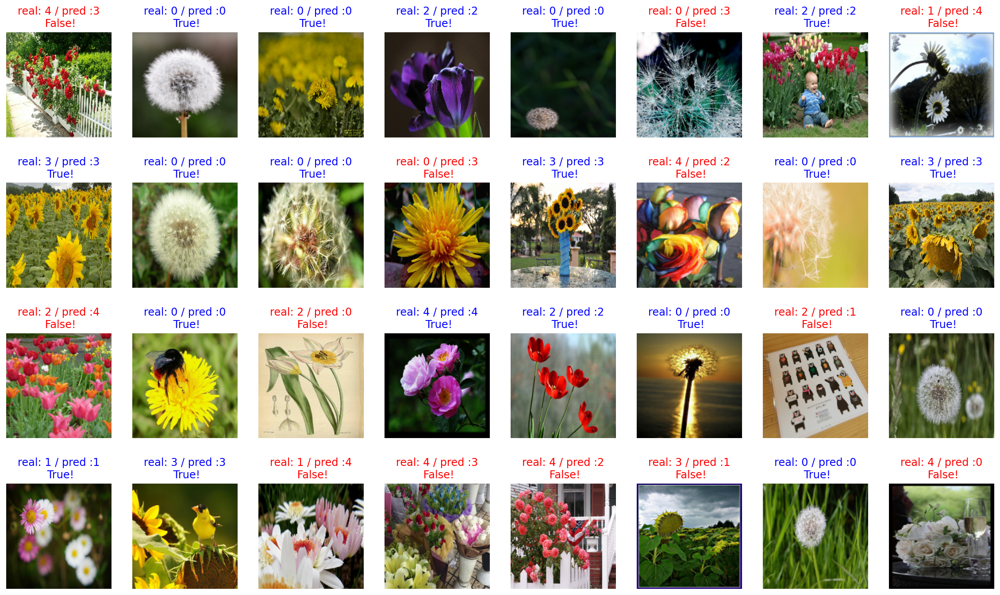

In [54]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

- 장족의 발전이다
- 틀린 사진들을 보면 비슷해보이는 (예시 4번 꽃) 것들(색이나 꽃밭의 형태) 가 비슷해서 그런 듯 하다. 
- 사진에 변주를 주면서 학습해야 할듯
- 과적합 위험성이 보인다. 모델 조정 필요

In [63]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break
    
predictions = np.argmax(predictions, axis=1)
predictions

array([3, 0, 0, 2, 0, 3, 2, 4, 3, 0, 0, 3, 3, 2, 0, 3, 4, 0, 0, 4, 2, 0,
       1, 0, 1, 3, 4, 3, 2, 1, 0, 0])

In [74]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
aug_images=[]
#augmentation이 적용된 image들을 시각화 해주는 함수
def show_aug_image(image, generator, n_images=4):
	
    # ImageDataGenerator는 여러개의 image를 입력으로 받기 때문에 4차원으로 입력 해야함.
    image_batch = np.expand_dims(image, axis=0)
	
    # featurewise_center or featurewise_std_normalization or zca_whitening 가 True일때만 fit 해주어야함
    generator.fit(image_batch) 
    # flow로 image batch를 generator에 넣어주어야함.
    data_gen_iter = generator.flow(image_batch)

#     fig, axs = plt.subplots(nrows=1, ncols=n_images, figsize=(24, 8))

    for i in range(n_images):
    	#generator에 batch size 만큼 augmentation 적용(매번 적용이 다름)
        aug_image_batch = next(data_gen_iter)
        aug_image = np.squeeze(aug_image_batch)
        aug_image = aug_image.astype('int')
#         axs[i].imshow(aug_image)
        aug_images.append(aug_image)

    print("이미지 변환 완료")
    return aug_images

data_generator = ImageDataGenerator(horizontal_flip=True)

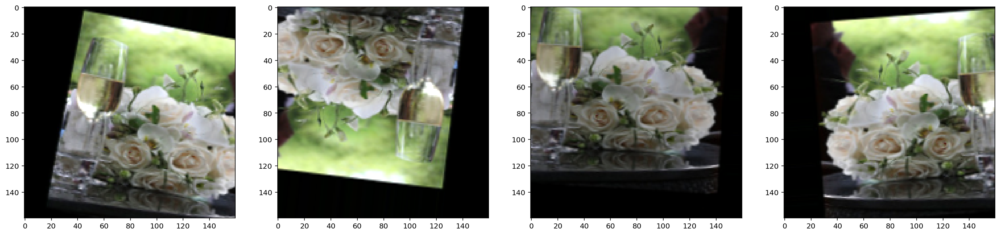

In [67]:
data_generator = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=(0.7, 1.3),
    horizontal_flip=True,
    vertical_flip=True,
    #rescale=1/255.0 # 학습시 적용, 시각화를 위해 임시로 주석처리
)

show_aug_image(image, data_generator, n_images=4)

In [110]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt

def aug_images(image, generator, n_images=4):
    image_batch = np.expand_dims(image, axis=0)
    data_gen_iter = generator.flow(image_batch)
    augmented_images = []  # 변환된 이미지를 저장할 리스트 초기화

    for _ in range(n_images):
        aug_image_batch = next(data_gen_iter)
        aug_image = np.squeeze(aug_image_batch)
        augmented_images.append(aug_image)  # 변환된 이미지를 리스트에 추가

    print("Generated images:", len(augmented_images))  # 생성된 이미지 수 출력
    return augmented_images  # 변환된 이미지 리스트 반환

def process_all_images(images, generator, n_images=4):
    all_augmented_images = []  # 모든 증강된 이미지를 저장할 리스트 초기화
    for image in images:
        image = (image + 1) / 2  # 이미지 전처리
        aug_images_result = aug_images(image, generator, n_images=n_images)  # 증강된 이미지 생성
        all_augmented_images.extend(aug_images_result)  # 결과 리스트에 추가
    print("모든 이미지 변환 완료!")  # 모든 이미지 처리가 끝난 후에 메시지 출력
    return all_augmented_images  # 모든 증강된 이미지를 포함하는 리스트 반환


# ImageDataGenerator 인스턴스 생성 예시
data_generator = ImageDataGenerator(horizontal_flip=True)

# 함수 사용 예시
# images는 넘파이 배열 형태의 이미지 데이터 리스트여야 합니다.
# 예를 들어, images = [np.random.rand(160, 160, 3) for _ in range(5)] 와 같이 이미지 리스트를 생성할 수 있습니다.
# process_all_images(images, data_generator, n_images=4)

In [111]:
augmented_images_list = process_all_images(images, data_generator, n_images=4)

Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
Generated images: 4
모든 이미지 변환 완료!


In [112]:
len(augmented_images_list)

128

In [96]:
data_generator

## Step 6. 모델 활용하기


- 본 데이터셋은 크기가 작은 편에 속한다(4000장 미만의 꽃 사진)
- 전이학습과 미세 조정 전략을 취한다. 사전에 학습된 모델의 지식을 활용하여 새로운, 비교적 작은 데이터셋에 대해 높은 성능을 달성할 수 있도록 한다.
- 전이학습 첫 단계에서는 사전 학습된 모델 가중치를 고정(freeze) 하여 사전 학습된 모델 가중치가 학습과정에서 업데이트 되지 않도록 한다.```base_model.trainable = False``` 이 단계에서는 사전 학습된 모델 위에 새로운 레이어(여기서는 분류를 위한 Dense 레이어)를 추가하고, 이 새로운 레이어만을 학습하여 초기의 고수준 특징을 재사용하면서 새로운 태스크에 맞게 모델을 조정하는 것이다.
- 모델의 초기 학습이 어느 정도 진행된 후, 사전 학습된 모델의 상위 레이어 몇 개를 "해동"하여 미세 조정을 진행할 수 있다. 즉, ```base_model.trainable = True```로 설정하고, 사전 학습된 모델의 일부 레이어만을 선택적으로 학습 가능하게 하여, 모델이 새로운 데이터에 대해 더 잘 적응하도록 하는 것이다. 미세 조정을 진행할 때는 학습률을 매우 낮게 설정하여, 학습된 가중치를 세밀하게 조정한다.

### VGG16

In [115]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout


# parameter Initialization
batch_size = 16
epochs = 10
IMG_HEIGHT = 160
IMG_WIDTH = 160

base_model = VGG16(input_shape=(IMG_HEIGHT, IMG_WIDTH, 3),
                   include_top=False,
                   weights='imagenet')

base_model.trainable = False  # VGG16의 가중치는 학습되지 않도록 설정

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)  # Dropout 추가
predictions = Dense(5, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)


learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])
              

# 15번 학습
EPOCHS = 15
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/15
92/92 [==============================] - 9s 82ms/step - loss: 1.5338 - accuracy: 0.3219 - val_loss: 1.2612 - val_accuracy: 0.6649
Epoch 2/15
92/92 [==============================] - 8s 82ms/step - loss: 1.2282 - accuracy: 0.5525 - val_loss: 1.0438 - val_accuracy: 0.6948
Epoch 3/15
92/92 [==============================] - 8s 82ms/step - loss: 1.0446 - accuracy: 0.6407 - val_loss: 0.9049 - val_accuracy: 0.7112
Epoch 4/15
92/92 [==============================] - 8s 82ms/step - loss: 0.9366 - accuracy: 0.6846 - val_loss: 0.8112 - val_accuracy: 0.7248
Epoch 5/15
92/92 [==============================] - 8s 83ms/step - loss: 0.8506 - accuracy: 0.7105 - val_loss: 0.7578 - val_accuracy: 0.7439
Epoch 6/15
92/92 [==============================] - 8s 81ms/step - loss: 0.7879 - accuracy: 0.7340 - val_loss: 0.7178 - val_accuracy: 0.7493
Epoch 7/15
92/92 [==============================] - 8s 80ms/step - loss: 0.7440 - accuracy: 0.7463 - val_loss: 0.6754 - val_accuracy: 0.7602
Epoch 8/15
92

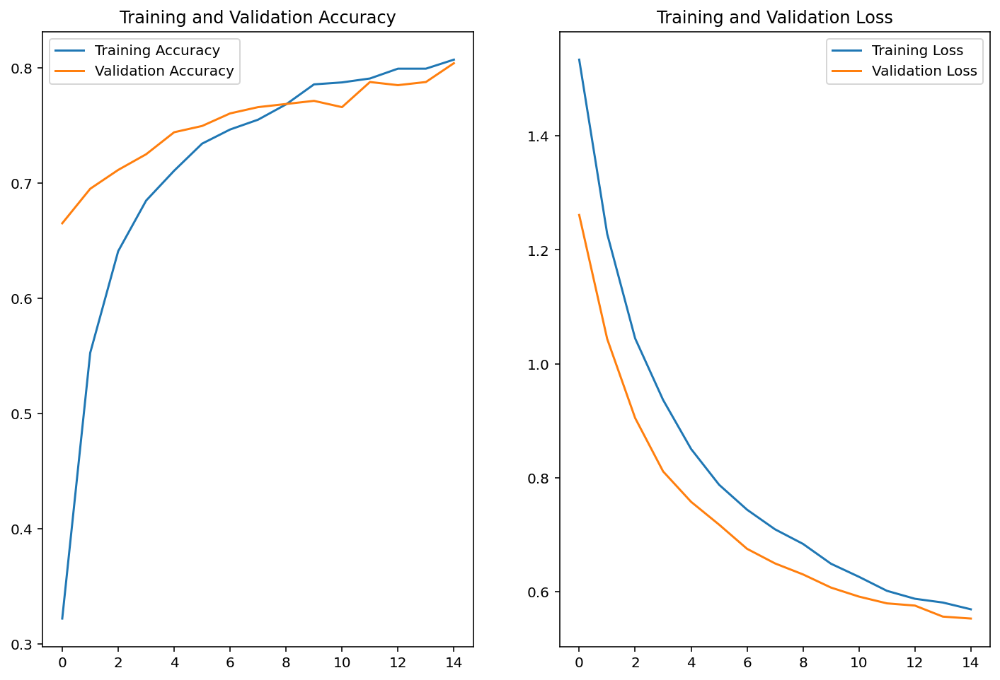

In [116]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

- 일단 미세조정 없이 돌려보고 결과를 확인해본다
- 과적합 징후가 사라졌고 val_acc이 확연히 높아졌따

In [117]:
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break
    
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 0, 3, 0, 0, 3, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       2, 0, 1, 3, 2, 4, 4, 3, 0, 4])

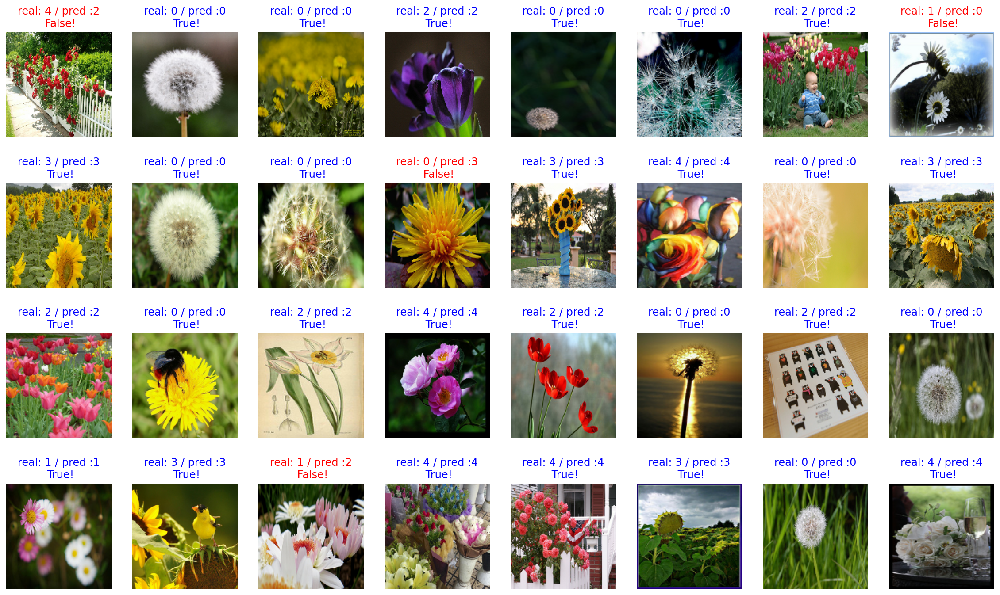

In [118]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

- 과적합 없이 잘 학습된 거 같아서 레이어를 조금 더 늘려서 다시 해보기로 했다.
- 0.80이면 단순히 epochs를 늘려도 될 것 같긴한데 일단 레이어를 먼저 늘려보기 

In [120]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0   

### 미세조정

In [21]:
from tensorflow.keras.applications import VGG16

# VGG16 모델 불러오기
base_model = VGG16(weights='imagenet', include_top=False)
base_model.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
______________________________________________________________

In [122]:
base_model.trainable = False  # VGG16의 가중치는 학습되지 않도록 설정

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)  # Dropout 추가
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)  # Dropout 추가
predictions = Dense(5, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)


learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])
              
EPOCHS = 20
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/20
92/92 [==============================] - 9s 82ms/step - loss: 1.4522 - accuracy: 0.3995 - val_loss: 1.1708 - val_accuracy: 0.6512
Epoch 2/20
92/92 [==============================] - 8s 81ms/step - loss: 1.1274 - accuracy: 0.5937 - val_loss: 0.8660 - val_accuracy: 0.7384
Epoch 3/20
92/92 [==============================] - 8s 82ms/step - loss: 0.8875 - accuracy: 0.6843 - val_loss: 0.7315 - val_accuracy: 0.7330
Epoch 4/20
92/92 [==============================] - 8s 82ms/step - loss: 0.7780 - accuracy: 0.7200 - val_loss: 0.6422 - val_accuracy: 0.7602
Epoch 5/20
92/92 [==============================] - 8s 82ms/step - loss: 0.7010 - accuracy: 0.7446 - val_loss: 0.6116 - val_accuracy: 0.7602
Epoch 6/20
92/92 [==============================] - 8s 81ms/step - loss: 0.6480 - accuracy: 0.7657 - val_loss: 0.5852 - val_accuracy: 0.7793
Epoch 7/20
92/92 [==============================] - 8s 81ms/step - loss: 0.6215 - accuracy: 0.7711 - val_loss: 0.5521 - val_accuracy: 0.7875
Epoch 8/20
92

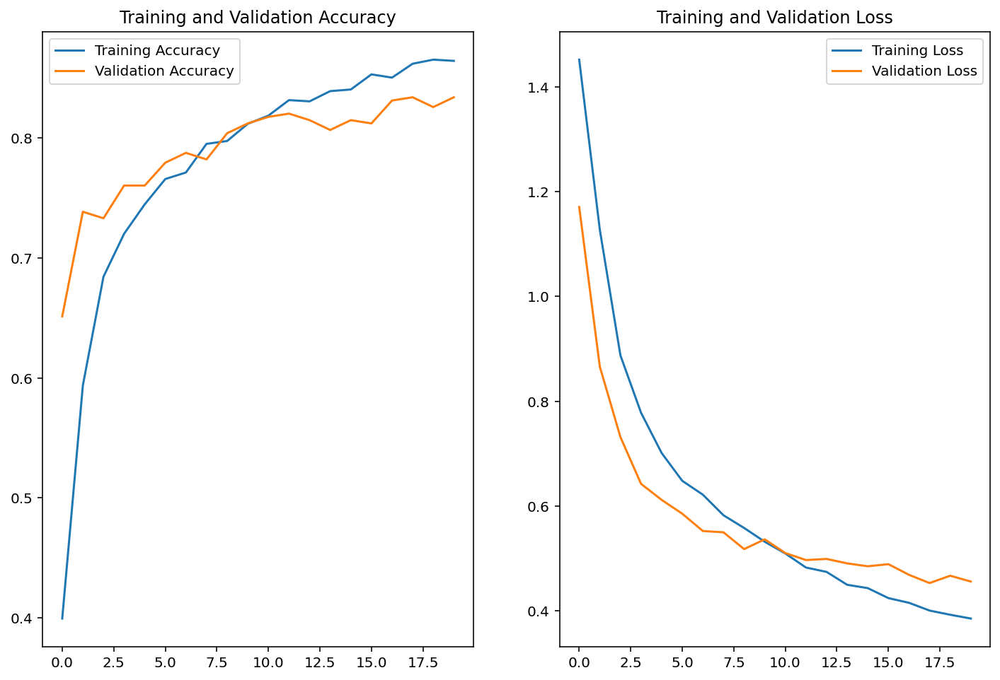

In [123]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

- 레이어를 추가하고(DropOut포함) 학습 횟수를 늘려봤다
- 0.83이 나왔다 약간의 과적합 징후가 보이는 아주 약간의.. 그래서 다른 방법을 더 써야 한다..

### 최종 모델

In [36]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import RMSprop

# IMG_SIZE = 224  # 이미지 사이즈 조정

# def format_example(image, label):
#     image = tf.cast(image, tf.float32)
#     image = (image/127.5) - 1
#     image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
#     return image, label

# train_batches = raw_train.map(format_example).batch(32)
# validation_batches = raw_validation.map(format_example).batch(32)
# test_batches = raw_test.map(format_example).batch(32)

# VGG16 모델 로드 및 커스텀 레이어 추가
base_model = VGG16(input_shape=(IMG_SIZE, IMG_SIZE, 3), include_top=False, weights='imagenet')
base_model.trainable = False

# 0.3 0.3 => 0.86
# 0.5 0.5 => 0.83
# 0.5 0.2 => 0.844
# 0.5 0.3 => 0.839
# 0.3 0.5 => 0.8419

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
predictions = Dense(5, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

# 모델 컴파일
model.compile(optimizer=RMSprop(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 초기 학습
EPOCHS = 15
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

# 미세 조정(Fine-tuning)
base_model.trainable = True

# 상위 레이어를 제외한 나머지 레이어는 고정
for layer in base_model.layers[:100]:
    layer.trainable = False

# 미세 조정을 위한 모델 컴파일
model.compile(optimizer=RMSprop(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 미세 조정 학습
fine_tune_epochs = 10
total_epochs = EPOCHS + fine_tune_epochs

history_fine = model.fit(train_batches,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_batches)

# 모델 평가
test_loss, test_accuracy = model.evaluate(test_batches)
print(f'Test loss: {test_loss}, Test accuracy: {test_accuracy}')

Epoch 1/15
92/92 [==============================] - 9s 86ms/step - loss: 1.4273 - accuracy: 0.4142 - val_loss: 1.1332 - val_accuracy: 0.6866
Epoch 2/15
92/92 [==============================] - 8s 85ms/step - loss: 1.0886 - accuracy: 0.6107 - val_loss: 0.8557 - val_accuracy: 0.7166
Epoch 3/15
92/92 [==============================] - 8s 87ms/step - loss: 0.8730 - accuracy: 0.6884 - val_loss: 0.7111 - val_accuracy: 0.7520
Epoch 4/15
92/92 [==============================] - 9s 88ms/step - loss: 0.7778 - accuracy: 0.7159 - val_loss: 0.6472 - val_accuracy: 0.7548
Epoch 5/15
92/92 [==============================] - 9s 86ms/step - loss: 0.7026 - accuracy: 0.7428 - val_loss: 0.6082 - val_accuracy: 0.7847
Epoch 6/15
92/92 [==============================] - 8s 85ms/step - loss: 0.6585 - accuracy: 0.7677 - val_loss: 0.5686 - val_accuracy: 0.7711
Epoch 7/15
92/92 [==============================] - 8s 84ms/step - loss: 0.6157 - accuracy: 0.7783 - val_loss: 0.5480 - val_accuracy: 0.7793
Epoch 8/15
92

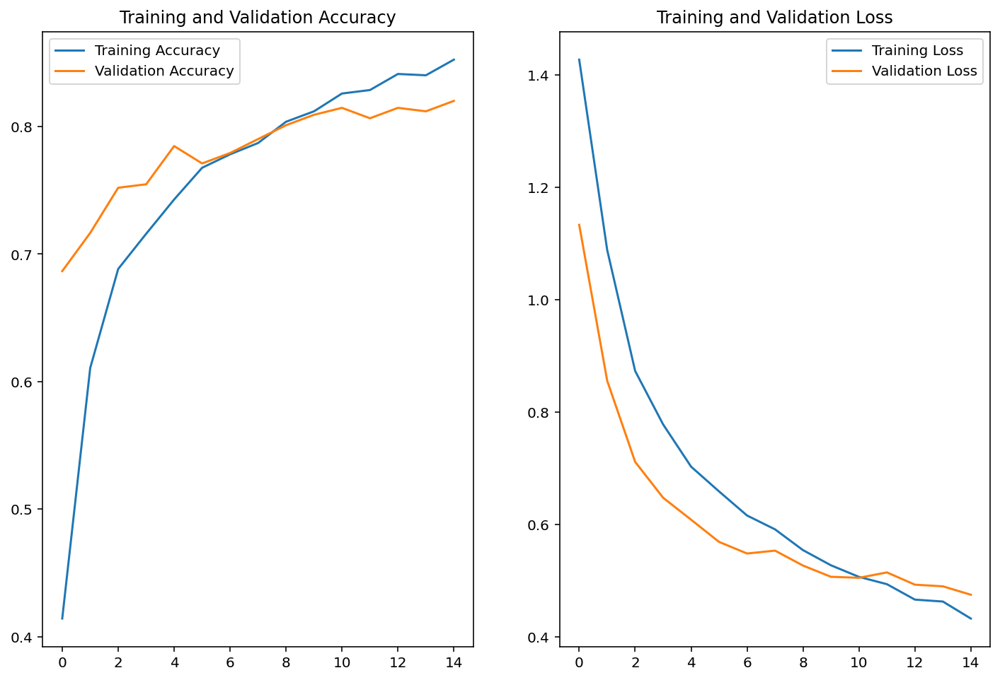

In [37]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

92/92 [==============================] - 8s 81ms/step - loss: 0.3483 - accuracy: 0.8760 - val_loss: 0.4494 - val_accuracy: 0.8501
- 듣어 나왔따 !!!!

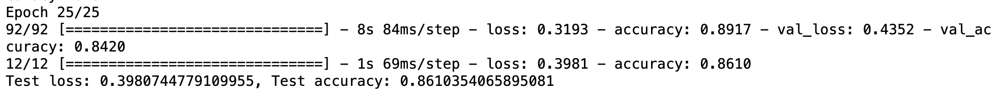
- 마지막에 약간의 과적합징후가 보이는 듯 했으나 test_Acc 85% 이상을 달성했다

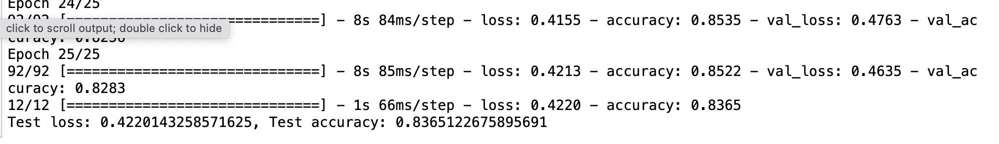
- Dropout 을 0.5로 올려서 학습하니 과적합 징후는 약간 방지되는 듯 보였으나 val_acc, test_acc 모두 감소했다

In [27]:
import numpy as np 

for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break
    
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 1, 3, 0, 0, 0, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       2, 0, 1, 3, 1, 4, 4, 3, 0, 4])

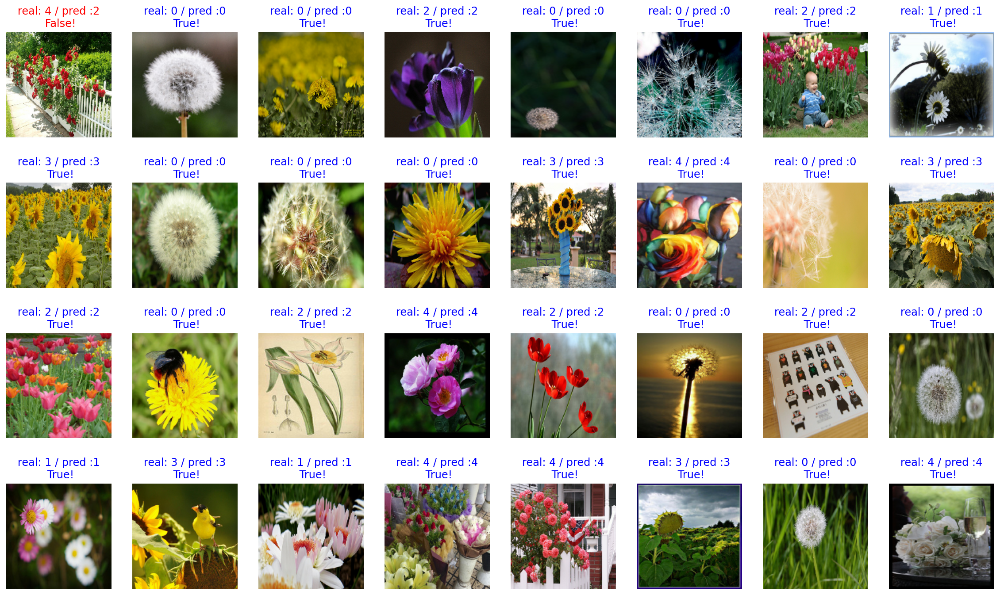

In [28]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [29]:
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 32 * 100) # 약 90% 내외

96.875


- 임의로 뽑아 테스트해보니 90% 이상의 예측 정확도가 나왔다 !

In [134]:
test_loss, test_accuracy = model.evaluate(test_batches)
print(f'Test loss: {np.round(test_loss,2)}')
print(f'Test accuracy: {np.round(test_accuracy,2)}')

12/12 [==============================] - 1s 64ms/step - loss: 0.4225 - accuracy: 0.8474
Test loss: 0.42
Test accuracy: 0.85


In [38]:
!mkdir -p ~/aiffel/flowers/checkpoint
# !mkdir -p ~/aiffel/flowers/images

In [39]:
# 모델 저장
import os

checkpoint_dir = os.getenv("HOME") + "/aiffel/flowers/checkpoint"
checkpoint_file_path = os.path.join(checkpoint_dir, 'checkpoint')

if not os.path.exists('checkpoint_dir'):
    os.mkdir('checkpoint_dir')
    
model.save_weights(checkpoint_file_path)     # checkpoint 파일 생성

if os.path.exists(checkpoint_file_path):
  print('checkpoint 파일 생성 OK!!')

checkpoint 파일 생성 OK!!


## 위에서 다 얼려서 다시 실행!
- layer 개수가 25
- 마지막 블록 레이어만 학습 가능하도록 설정

In [64]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import RMSprop


base_model = VGG16(input_shape=(IMG_SIZE, IMG_SIZE, 3), include_top=False, weights='imagenet')
base_model.trainable = False

# 모델 구성
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)  
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)  
predictions = Dense(5, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

# 모델 컴파일
model.compile(optimizer=RMSprop(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 초기 학습
EPOCHS = 15
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

# 미세 조정(Fine-tuning)
base_model.trainable = True

# 마지막 블록의 레이어만 학습 가능하게 설정
for layer in base_model.layers[:-4]:
    layer.trainable = False

# 미세 조정을 위한 모델 컴파일
model.compile(optimizer=RMSprop(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# 미세 조정 학습
fine_tune_epochs = 10
total_epochs = EPOCHS + fine_tune_epochs

history_fine = model.fit(train_batches,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_batches)

# 모델 평가
test_loss, test_accuracy = model.evaluate(test_batches)
print(f'Test loss: {test_loss}, Test accuracy: {test_accuracy}')


Epoch 1/15
92/92 [==============================] - 9s 82ms/step - loss: 1.4480 - accuracy: 0.3992 - val_loss: 1.1458 - val_accuracy: 0.6649
Epoch 2/15
92/92 [==============================] - 8s 81ms/step - loss: 1.1050 - accuracy: 0.5957 - val_loss: 0.8696 - val_accuracy: 0.7084
Epoch 3/15
92/92 [==============================] - 8s 81ms/step - loss: 0.9010 - accuracy: 0.6751 - val_loss: 0.7433 - val_accuracy: 0.7166
Epoch 4/15
92/92 [==============================] - 8s 81ms/step - loss: 0.7659 - accuracy: 0.7238 - val_loss: 0.6368 - val_accuracy: 0.7466
Epoch 5/15
92/92 [==============================] - 8s 81ms/step - loss: 0.7067 - accuracy: 0.7456 - val_loss: 0.6442 - val_accuracy: 0.7493
Epoch 6/15
92/92 [==============================] - 8s 82ms/step - loss: 0.6574 - accuracy: 0.7681 - val_loss: 0.5720 - val_accuracy: 0.7766
Epoch 7/15
92/92 [==============================] - 8s 83ms/step - loss: 0.6146 - accuracy: 0.7847 - val_loss: 0.5894 - val_accuracy: 0.7793
Epoch 8/15
92

- 레이어층을 잘못 세서 결과적으로 다 얼리고 하는 형태로만 했는데 의도한대로 밑에 block층만 해동시킨후 다시 학습을 시켜보니 테스트 결과는 0.86으로 상승했다 !


In [73]:
print(len(model.layers))

25


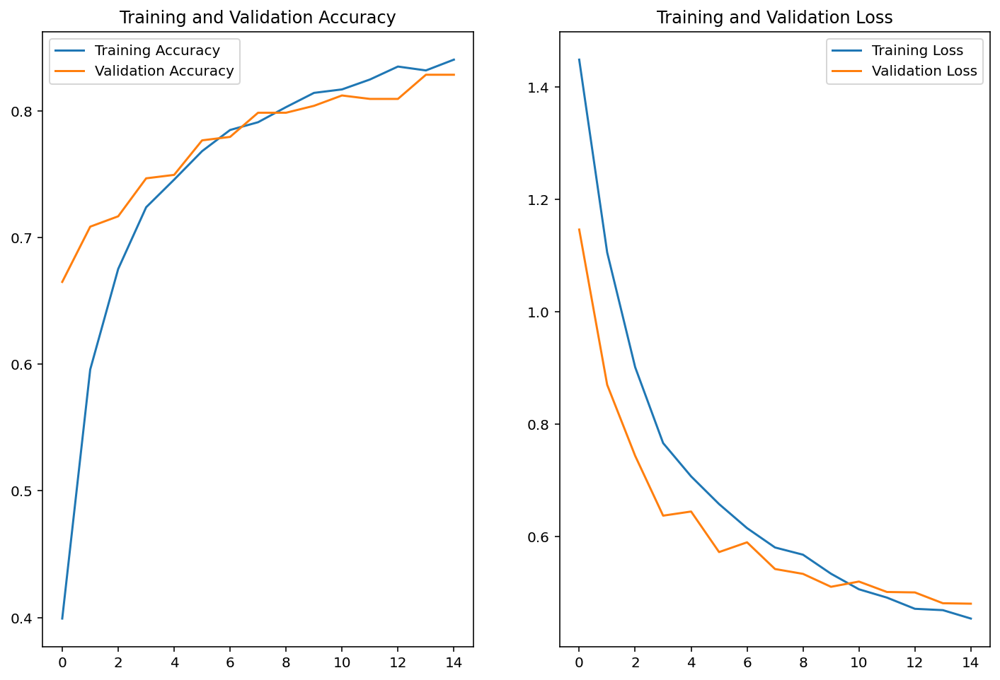

In [65]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend()
plt.title('Training and Validation Loss')
plt.show()

- 학습상태도 나쁘지 않다
- 저장해야지

In [66]:
# 모델 저장
import os

checkpoint_dir = os.getenv("HOME") + "/aiffel/flowers/checkpoint"
checkpoint_file_path = os.path.join(checkpoint_dir, 'checkpoint')

if not os.path.exists('checkpoint_dir'):
    os.mkdir('checkpoint_dir')
    
model.save_weights(checkpoint_file_path)     # checkpoint 파일 생성

if os.path.exists(checkpoint_file_path):
  print('checkpoint 파일 생성 OK!! 굿')

checkpoint 파일 생성 OK!! 굿


#### 참고용
- 특히, 사전 학습된 모델을 사용할 때, 특성 추출기(feature extractor)인 사전 학습된 모델의 레이어는 그대로 두고, 새롭게 추가하는 분류기 부분에 Dropout을 적용하여 과적합을 방지하는 것이 일반적입니다.

- 이 경우, Dropout은 모델이 학습 데이터의 노이즈에 덜 민감하게 만들어 주며, 이는 모델의 일반화 성능을 향상시키는 데 도움이 됩니다. 분류기에서의 Dropout 적용은 특히 새로운 데이터셋에 대해 모델을 미세 조정할 때 유용하게 사용됩니다.

### 번외. 꽃을 찾자?!

In [1]:
!ln -s ~/data/* ~/aiffel/flowers/images/

In [2]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

- 파라미터로 이미지 사이즈 받아오기
- (160, 160) 사이즈만 입력받을 수 있기에...

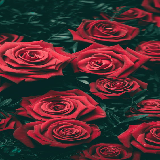

In [5]:
import os
IMG_SIZE = 160
img_dir_path = os.getenv("HOME") + "/aiffel/flowers/images"
flower_image_path = os.path.join(img_dir_path, 'rose1.jpeg')

rose_image = load_img(flower_image_path, target_size=(IMG_SIZE, IMG_SIZE))
rose_image

- 모델에 넣기 위해 이미지를 array, 배열 자료형으로 변환

In [6]:
rose_image = img_to_array(rose_image).reshape(1, IMG_SIZE, IMG_SIZE, 3)
rose_image.shape

(1, 160, 160, 3)

In [40]:
prediction = model.predict(rose_image)
prediction

array([[1.6287030e-10, 1.0000000e+00, 1.7335221e-01, 9.9998450e-01,
        9.9999690e-01]], dtype=float32)

In [43]:
class_names = metadata.features['label'].names

In [46]:
def show_and_predict_image(dirpath, filename, img_size=160):
    filepath = os.path.join(dirpath, filename)
    image = load_img(filepath, target_size=(img_size, img_size))
    plt.imshow(image)
    plt.axis('off')
    image = img_to_array(image).reshape(1, img_size, img_size, 3)
    prediction = model.predict(image)[0]
    pred_index = np.argmax(prediction)
    pred_label = class_names[pred_index]
    print(f"This image seems {pred_label} with a probibility of {np.max(prediction)}.")

This image seems daisy with a probibility of 1.0.


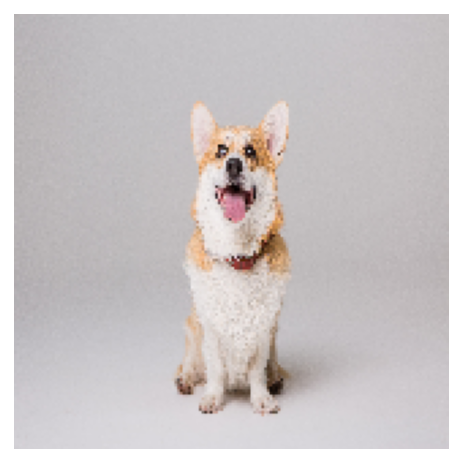

In [47]:
filename = 'my_dog.jpg'

show_and_predict_image(img_dir_path, filename)

In [49]:
img_dir_path

'/aiffel/aiffel/flowers/images'

This image seems tulips with a probibility of 1.0.


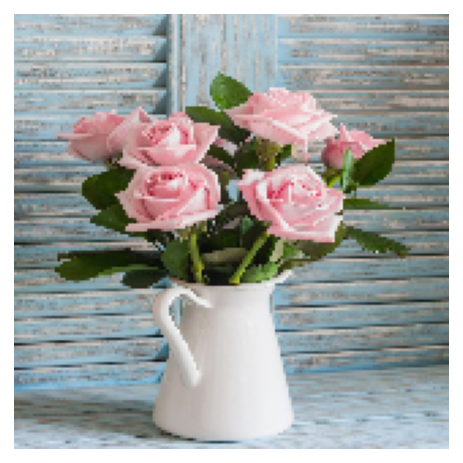

In [51]:
filename = 'rose2.jpeg'

show_and_predict_image(img_dir_path, filename)

This image seems daisy with a probibility of 1.0.


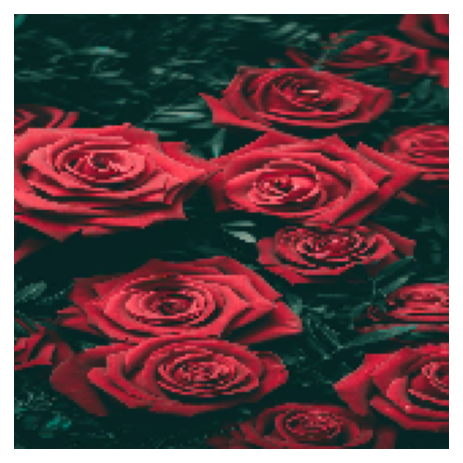

In [54]:
filename = 'rose1.jpeg'

show_and_predict_image(img_dir_path, filename)

This image seems tulips with a probibility of 1.0.


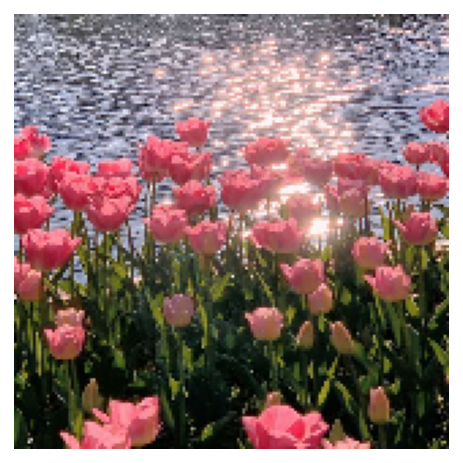

In [52]:
filename = "tulip1.jpeg"
show_and_predict_image(img_dir_path, filename)

This image seems tulips with a probibility of 1.0.


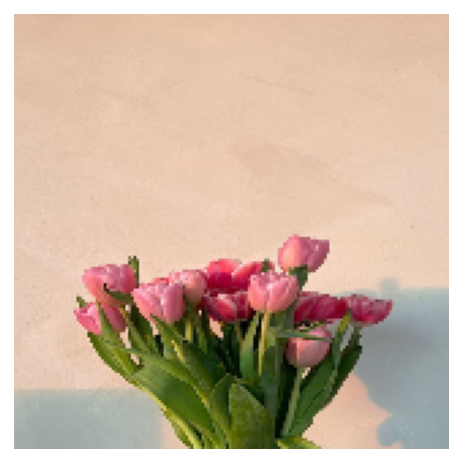

In [53]:
filename = "tulips.jpeg"
show_and_predict_image(img_dir_path, filename)

This image seems daisy with a probibility of 1.0.


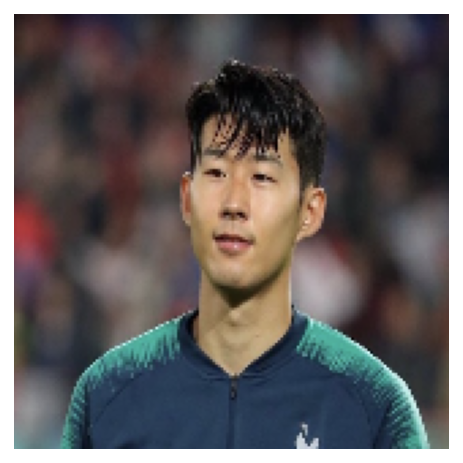

In [55]:
filename = "son.png"
show_and_predict_image(img_dir_path, filename)

- 튤립은 잘 분류해내지만 장미를 뽑아내질 못한다.
- 사람은 데이지 강아지는 데이지
- 이전 프로젝트에서 사람을 전부 강아지로 인식하던데 여기에서 강아지 사람 모두 데이지로 인식하니 한편으로는 일관된 결과를 보인다.

## 회고

TensorFlow와 Keras를 사용하여 사전 학습된 VGG16 모델을 기반으로 꽃 이미지 분류 작업을 수행했다. 전이 학습과 미세 조정을 통해 모델을 훈련시켰고, 과적합을 방지하기 위한 전략으로 Dropout을 조정하는 접근 방법을 시도했다.

1. 핵심 성과

- 훈련 및 검증 정확도와 손실을 시각화하여 모델의 학습 과정을 분석. 이를 통해 모델이 학습 데이터에 잘 적응하고 있으며, 검증 데이터에 대해서도 안정적인 성능을 보이는 것을 확인. 최종 테스트 정확도가 85% 이상을 달성하며, 프로젝트의 목표 달성.

2. 문제상황 및 해결:

    1) 과적합
    - 과적합의 징후가 나타날 때, Dropout 비율을 조정하여 모델의 과적합 방지 시도. 0.2~ 0.3~ 0.5
    - Dropout 비율을 증가시켰을 때, 과적합 징후는 다소 감소했으나, 검증 정확도와 테스트 정확도 모두 소폭 감소하는 결과. 이는 Dropout이 모델의 학습 능력을 일정 부분 제한하기 때문에 발생하는 현상으로 보임
    
   2) 전이학습과 미세조정
    - 프로젝트 초기 단계에서는 VGG16 모델의 가중치를 고정(```base_model.trainable = False```)하여 전이 학습 수행. 이 방식으로 모델은 사전에 학습된 패턴을 활용해 꽃 이미지를 분류하는 데 필요한 고수준 특성 추출함. 
    - 그러나 초기 학습만으로는 검증 데이터셋에 대한 성능이 포화 상태에 도달. 이를 해결하기 위해, 학습의 후반 단계에서는 사전 학습된 모델의 상위 층을 해동(```base_model.trainable = True```로 설정하고, 특정 층만 학습 가능하게 조정)하여 미세 조정 수행. 미세 조정으로 모델은 새로운 데이터셋의 특정 특성에 더 잘 적응함


3. 결론 및 향후 방향성

- 전이 학습과 미세 조정은 작은 데이터셋에 대해서도 높은 성능의 모델을 구축할 수 있는 강력한 방법
- 과적합을 방지하기 위한 전략으로 Dropout 비율을 조정하는 것이 유용하지만, 이를 통해 모델의 성능에 미치는 영향을 주의 깊게 관찰해야 함
+ 데이터 증강, 정규화 기법, 더 세밀한 미세 조정 등을 통해 모델의 성능을 더욱 향상시키고, 과적합을 효과적으로 방지하는 방법 추가 탐색.
